# Image Colorization with U-Net and GAN Tutorial

In [1]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [6]:
# if use_colab == True:
#     path = coco_path
# else:
#     path = "Your path to the dataset"
    
paths = glob.glob(coco_path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 5000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(5000)
train_idxs = rand_idxs[:4000] # choosing the first 4000 as training set
val_idxs = rand_idxs[4000:] # choosing last 1000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

4000 1000


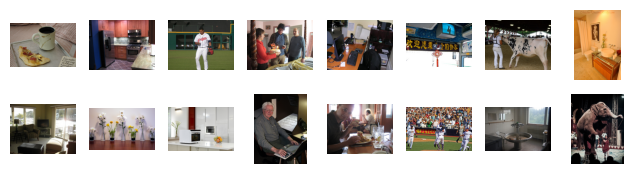

In [7]:
_, axes = plt.subplots(2, 8,figsize = [8,2])
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [8]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab,'image': img, }
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=0, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

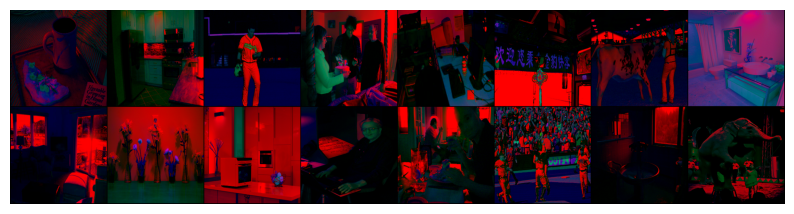

In [9]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
# Ls, abs_ = data['L'], data['ab']
# print(Ls.shape, abs_.shape)
# print(len(train_dl), len(val_dl))

# data = next(iter(train_dl))
Ls, abs_, img = data['L'], data['ab'], data['image']
imgs = torch.cat((Ls, abs_), dim=1)
grid = make_grid(imgs, nrow=8)

# # Display the images in a 2x8 grid
plt.figure(figsize=(10, 5))
plt.imshow(grid.permute(1, 2, 0))
plt.axis('off')
plt.show()



### 1.3- Generator proposed by the paper

In [10]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

### 1.4- Discriminator

In [11]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

Let's take a look at its blocks:

### 1.5- GAN Loss

This is a handy class we can use to calculate the GAN loss of our final model. In the __init__ we decide which kind of loss we're going to use (which will be "vanilla" in our project) and register some constant tensors as the "real" and "fake" labels. Then when we call this module, it makes an appropriate tensor full of zeros or ones (according to what we need at the stage) and computes the loss.

In [12]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

### 1.x Model Initialization

In [13]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

### 1.6- Putting everything together

In [14]:
import torch.nn.functional as F
import math

def color_accuracy(pred, target):
    mse = F.mse_loss(pred, target)
    color_acc = 1 - mse/(torch.var(target) + 1e-6)
    return color_acc.item()



In [15]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
    
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

    def test(self):
        self.net_G.eval()
        color_acc = color_accuracy(self.fake_color, self.ab)
        return color_acc

### 1.xx Utility functions

In [16]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    print("model visulaize")
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(4):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

### 1.7- Training function

In [17]:
# !pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

That's it! With just these few lines of code you can build such a complex model easily. create_body function loads the pretrained weights of the ResNet18 architecture and cuts the model to remove the last two layers (GlobalAveragePooling and a Linear layer for the ImageNet classification task). Then, DynamicUnet uses this backbone to build a U-Net with the needed output channels (2 in our case) and with an input size of 256.

### 2.2 Pretraining the generator for colorization task

In [18]:

def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = resnet18(pretrained=True)
    body = create_body(model, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G


In [ ]:
pretrain_loss = []
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
        
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")
        pretrain_loss.append(loss_meter.avg)

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
pretrain_generator(net_G, train_dl, opt, criterion, 20)
torch.save(net_G.state_dict(), "res18-unet3.pt")

  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 1/20
L1 Loss: 0.09226


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 2/20
L1 Loss: 0.08492


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 3/20
L1 Loss: 0.08413


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 4/20
L1 Loss: 0.08371


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 5/20
L1 Loss: 0.08329


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 6/20
L1 Loss: 0.08306


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 7/20
L1 Loss: 0.08276


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 8/20
L1 Loss: 0.08256


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 9/20
L1 Loss: 0.08220


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 10/20
L1 Loss: 0.08199


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 11/20
L1 Loss: 0.08201


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 12/20
L1 Loss: 0.08145


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 13/20
L1 Loss: 0.08137


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 14/20
L1 Loss: 0.08103


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 15/20
L1 Loss: 0.08084


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 16/20
L1 Loss: 0.07986


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 17/20
L1 Loss: 0.07931


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 18/20
L1 Loss: 0.07831


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 19/20
L1 Loss: 0.07791


  0%|          | 0/157 [00:00<?, ?it/s]

Epoch 20/20
L1 Loss: 0.07672


In [ ]:
# !gdown --id 1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV

In [ ]:
torch.save(net_G.state_dict(), "res18-unet3.pt")

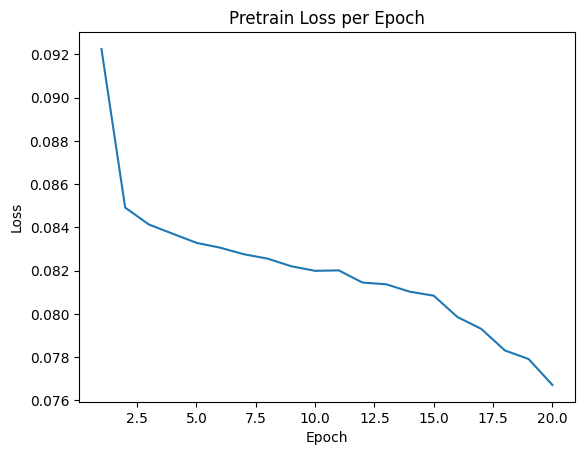

In [ ]:
import matplotlib.pyplot as plt

epochs = len(pretrain_loss)
plt.plot(range(1, epochs+1), pretrain_loss)
plt.title("Pretrain Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.show()

In [19]:
epoch_losses={'loss_D':[], 'loss_G':[], 'color_acc':[]}

def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0 
        iteration_losses=[]
        color_acc_epoch = 0 
        n_batches = 0                              # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            model.test()
            color_acc_epoch += model.test()
            n_batches += 1
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            iteration_losses.append([loss_meter_dict['loss_D'].avg,loss_meter_dict['loss_G'].avg]) #ERROR
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs
        epoch_losses['loss_D'].append(iteration_losses[0][0])
        epoch_losses['loss_G'].append(iteration_losses[1][0])
        epoch_losses['color_acc'].append(color_acc_epoch/n_batches)
        model_path = f'final_model_epoch_{e+1}.pt'
        torch.save(model.state_dict(), model_path)
         
        # return epoch_losses

With this simple function, we pretrain the generator for 20 epochs and then we save its weights. This will take an hour on Colab. In the following section, we will use this model as the generator for our GAN and train the whole network as before:

### 2.3 Putting everything together, again!

If you want to train the model yourself, run the following cell. Instead, if you want to use the pretrained weights, skip the cell and run the one after that. 

In [ ]:
# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# net_G.load_state_dict(torch.load("/content/drive/MyDrive/res18-unet.pt", map_location=device))
# model = MainModel(net_G=net_G)
# train_model(model, train_dl, 20)
# torch.save(model.state_dict(), 'final_model3.pt')

In [20]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
model = MainModel(net_G=net_G)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 305MB/s]


model initialized with norm initialization


In [21]:
criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [22]:
checkpoint = torch.load("/content/drive/MyDrive/final_model.pt")
model.load_state_dict(checkpoint)

<All keys matched successfully>

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 1/20
Iteration 200/250
loss_D_fake: 0.53129
loss_D_real: 0.50859
loss_D: 0.51994
loss_G_GAN: 1.44761
loss_G_L1: 10.05433
loss_G: 11.50195
model visulaize


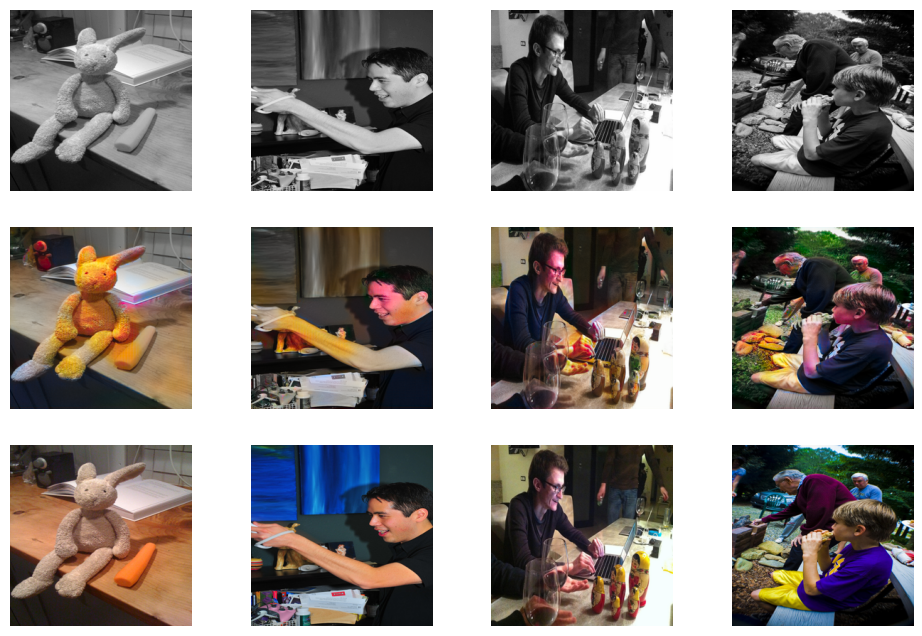

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 2/20
Iteration 200/250
loss_D_fake: 0.58024
loss_D_real: 0.55857
loss_D: 0.56940
loss_G_GAN: 1.22049
loss_G_L1: 9.71197
loss_G: 10.93246
model visulaize


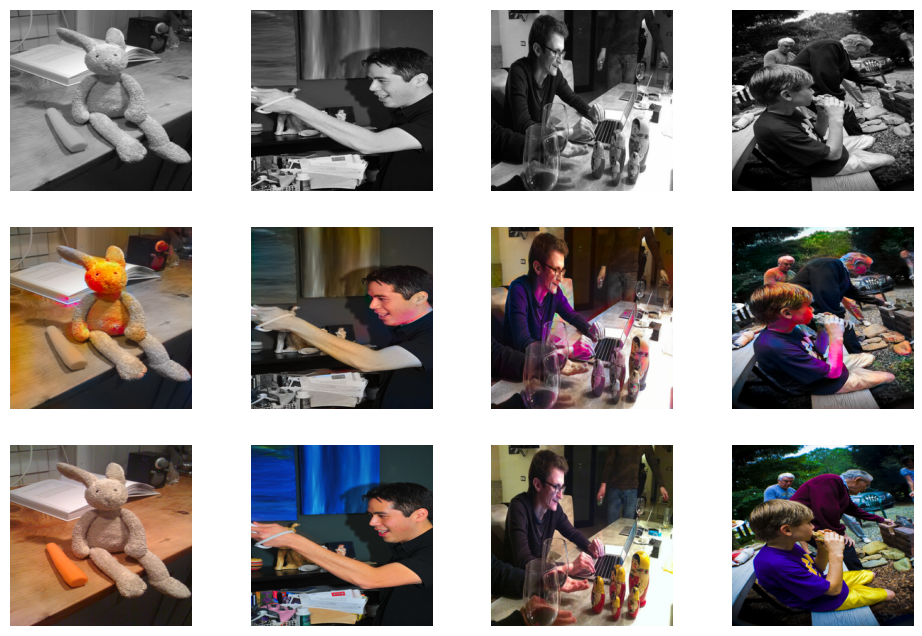

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 3/20
Iteration 200/250
loss_D_fake: 0.58703
loss_D_real: 0.57681
loss_D: 0.58192
loss_G_GAN: 1.12736
loss_G_L1: 9.32747
loss_G: 10.45482
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)


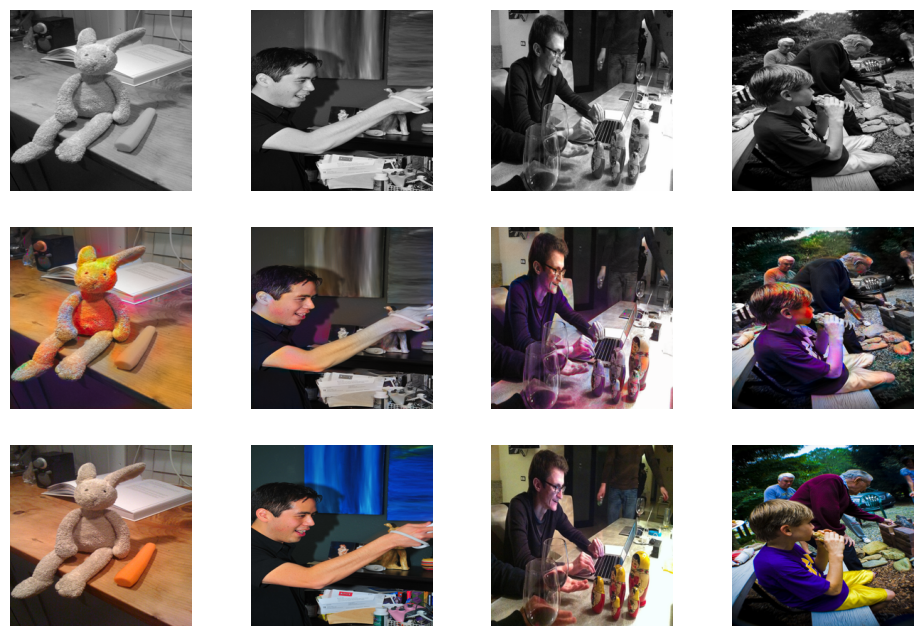

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 4/20
Iteration 200/250
loss_D_fake: 0.59240
loss_D_real: 0.57970
loss_D: 0.58605
loss_G_GAN: 1.12615
loss_G_L1: 9.05987
loss_G: 10.18602
model visulaize


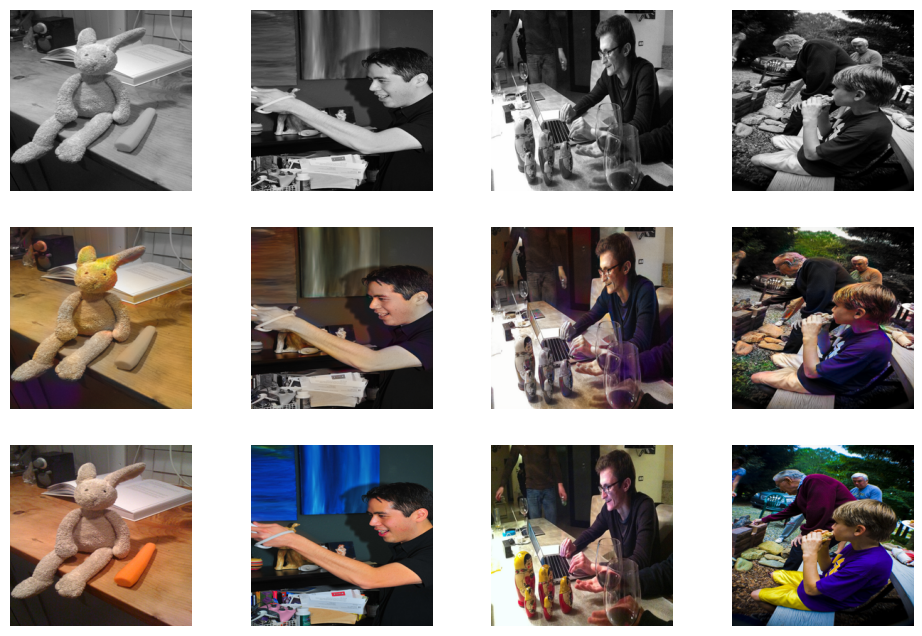

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 5/20
Iteration 200/250
loss_D_fake: 0.59274
loss_D_real: 0.58963
loss_D: 0.59118
loss_G_GAN: 1.11072
loss_G_L1: 8.76594
loss_G: 9.87666
model visulaize


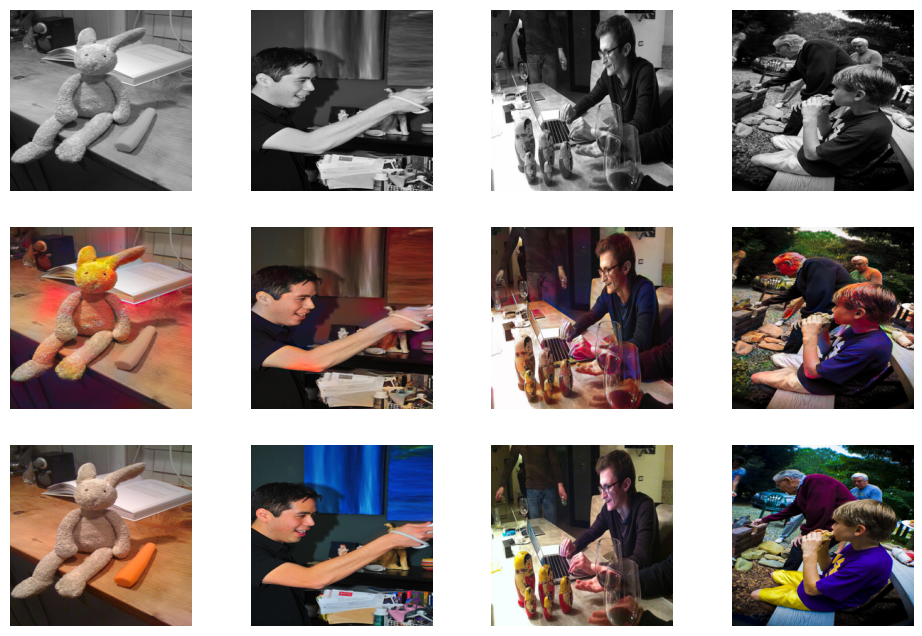

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 6/20
Iteration 200/250
loss_D_fake: 0.60233
loss_D_real: 0.58688
loss_D: 0.59460
loss_G_GAN: 1.06544
loss_G_L1: 8.47032
loss_G: 9.53576
model visulaize


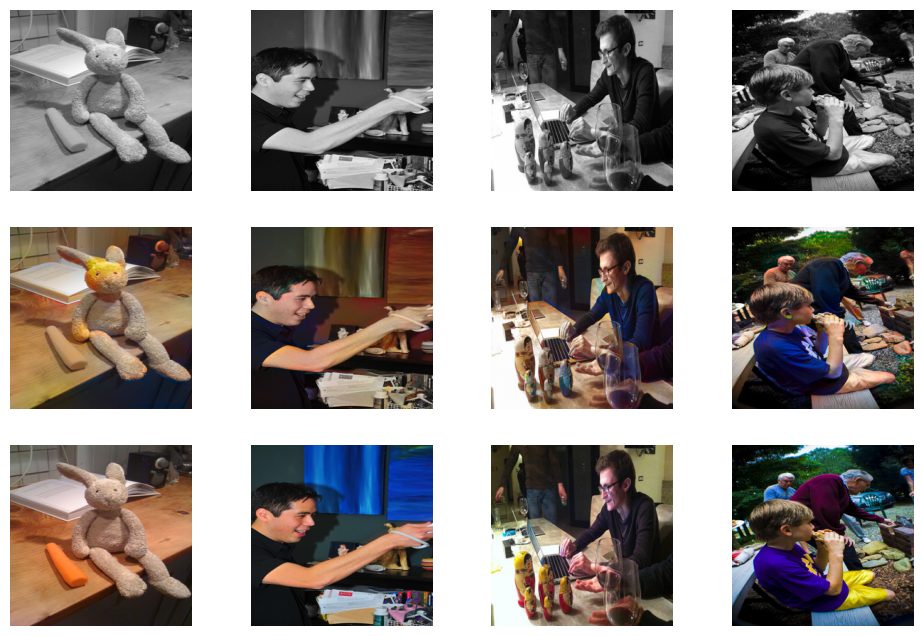

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 7/20
Iteration 200/250
loss_D_fake: 0.60999
loss_D_real: 0.60527
loss_D: 0.60763
loss_G_GAN: 1.02154
loss_G_L1: 8.17011
loss_G: 9.19165
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)


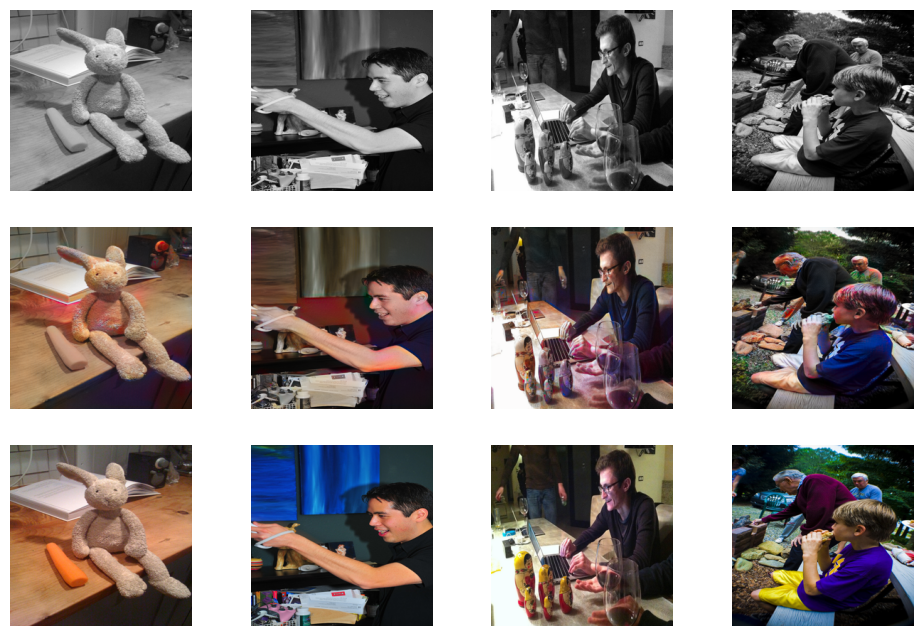

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 8/20
Iteration 200/250
loss_D_fake: 0.61248
loss_D_real: 0.60841
loss_D: 0.61045
loss_G_GAN: 1.01605
loss_G_L1: 7.94759
loss_G: 8.96363
model visulaize


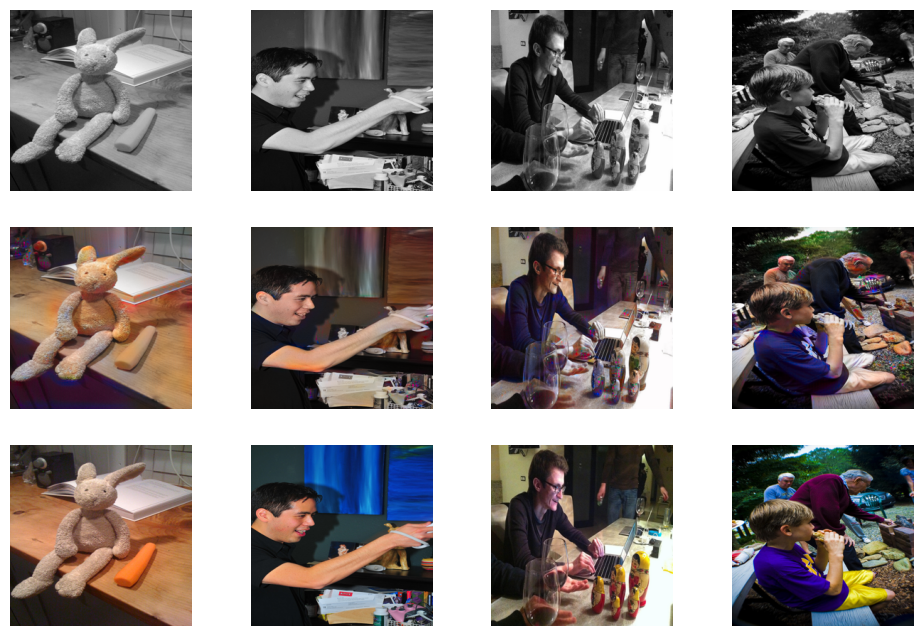

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 9/20
Iteration 200/250
loss_D_fake: 0.60846
loss_D_real: 0.60783
loss_D: 0.60815
loss_G_GAN: 1.00686
loss_G_L1: 7.74330
loss_G: 8.75015
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return func(*args, **kwargs)


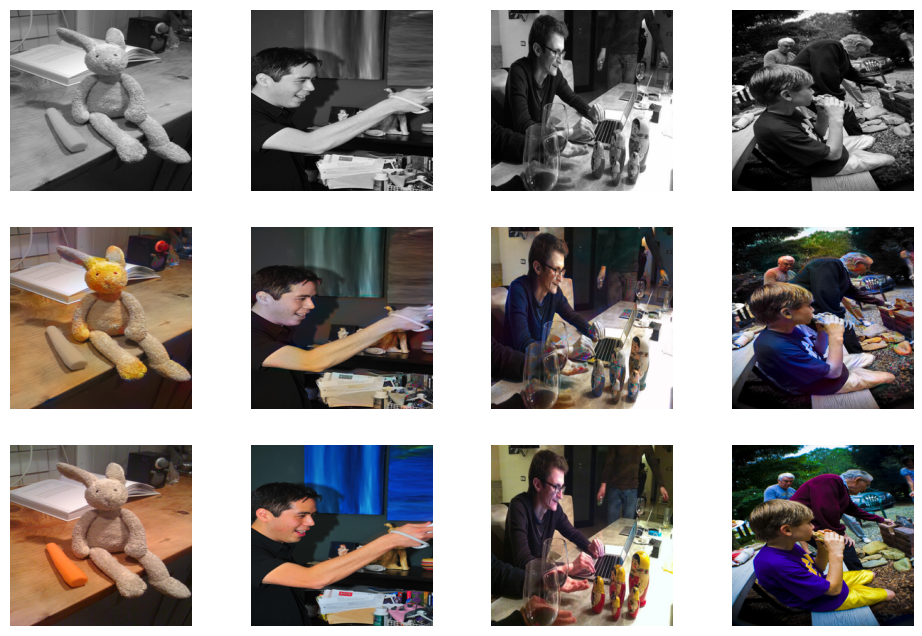

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 10/20
Iteration 200/250
loss_D_fake: 0.61525
loss_D_real: 0.60405
loss_D: 0.60965
loss_G_GAN: 1.01307
loss_G_L1: 7.51445
loss_G: 8.52751
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)


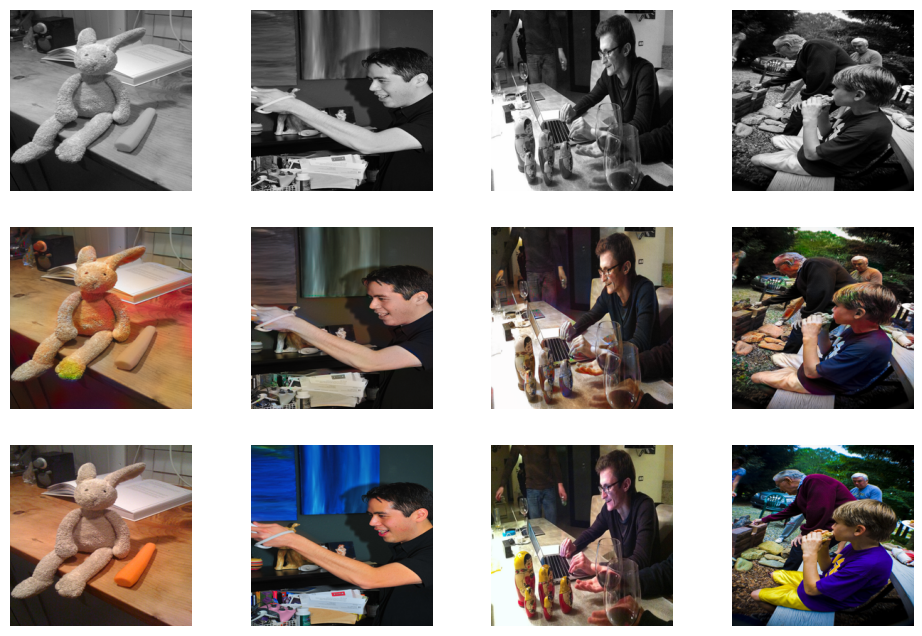

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 11/20
Iteration 200/250
loss_D_fake: 0.61744
loss_D_real: 0.61289
loss_D: 0.61516
loss_G_GAN: 0.97958
loss_G_L1: 7.34040
loss_G: 8.31998
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)


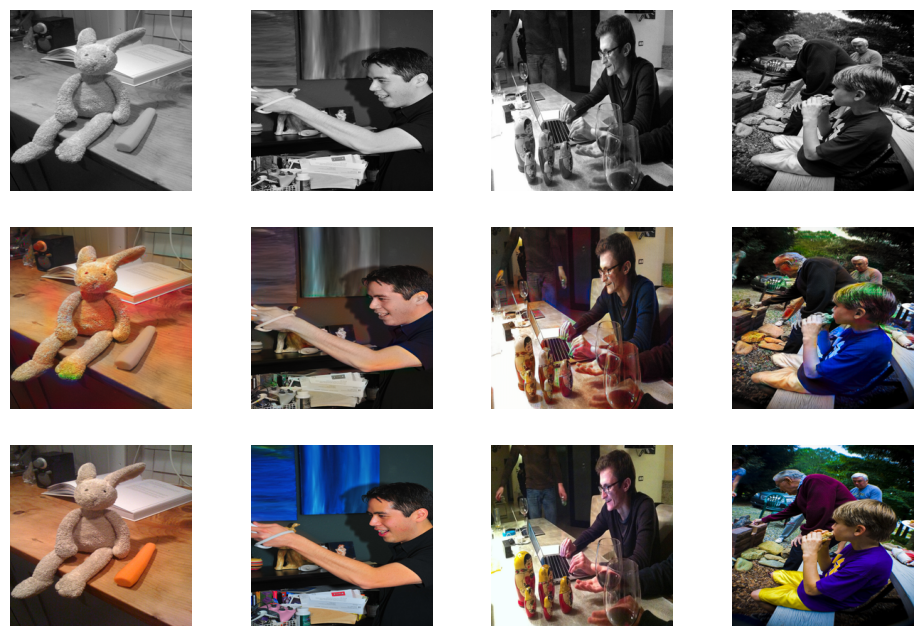

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 12/20
Iteration 200/250
loss_D_fake: 0.61744
loss_D_real: 0.61235
loss_D: 0.61489
loss_G_GAN: 0.97586
loss_G_L1: 7.20930
loss_G: 8.18516
model visulaize


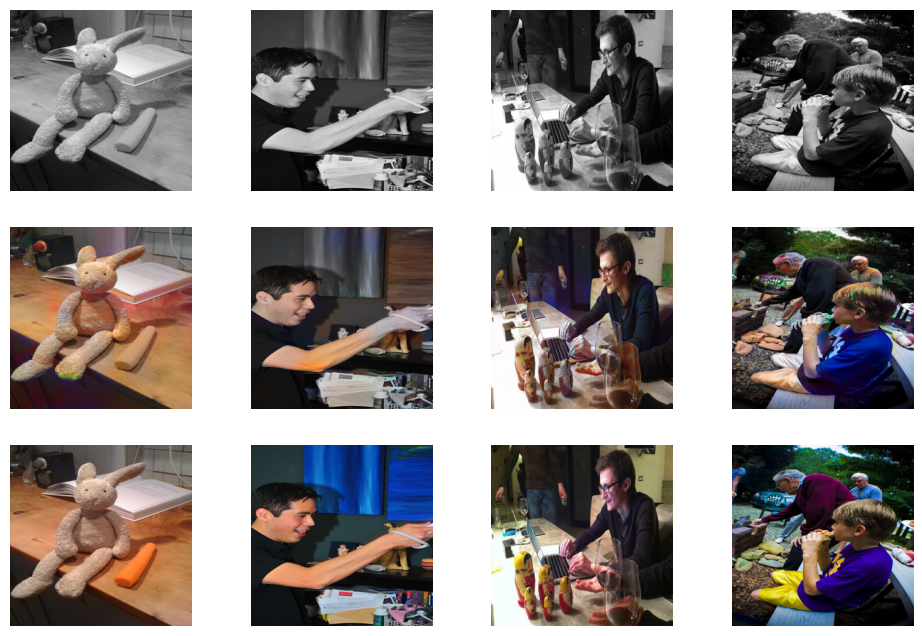

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 13/20
Iteration 200/250
loss_D_fake: 0.61576
loss_D_real: 0.61728
loss_D: 0.61652
loss_G_GAN: 0.97366
loss_G_L1: 7.05478
loss_G: 8.02844
model visulaize


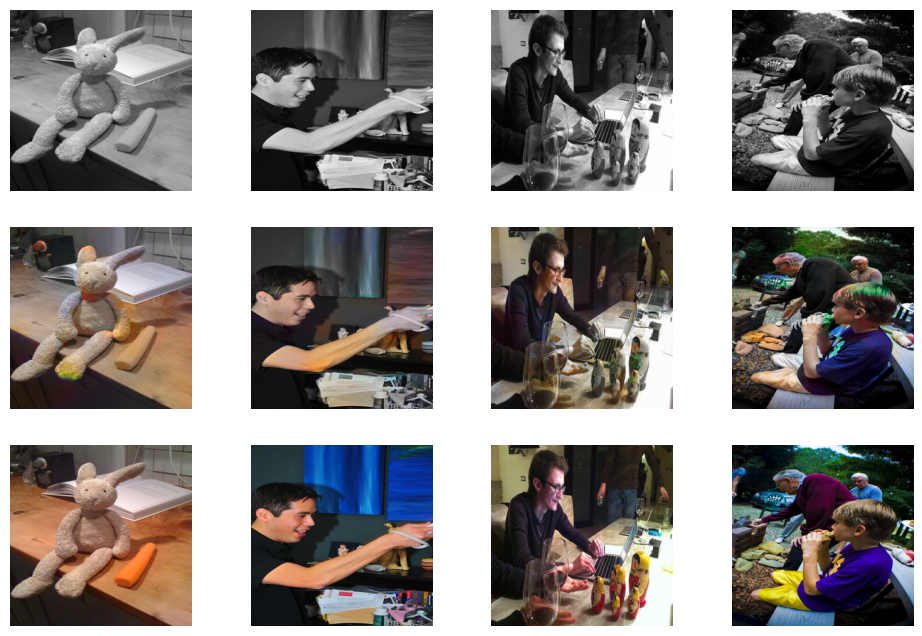

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 14/20
Iteration 200/250
loss_D_fake: 0.61801
loss_D_real: 0.61464
loss_D: 0.61633
loss_G_GAN: 0.97199
loss_G_L1: 6.89087
loss_G: 7.86287
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return func(*args, **kwargs)


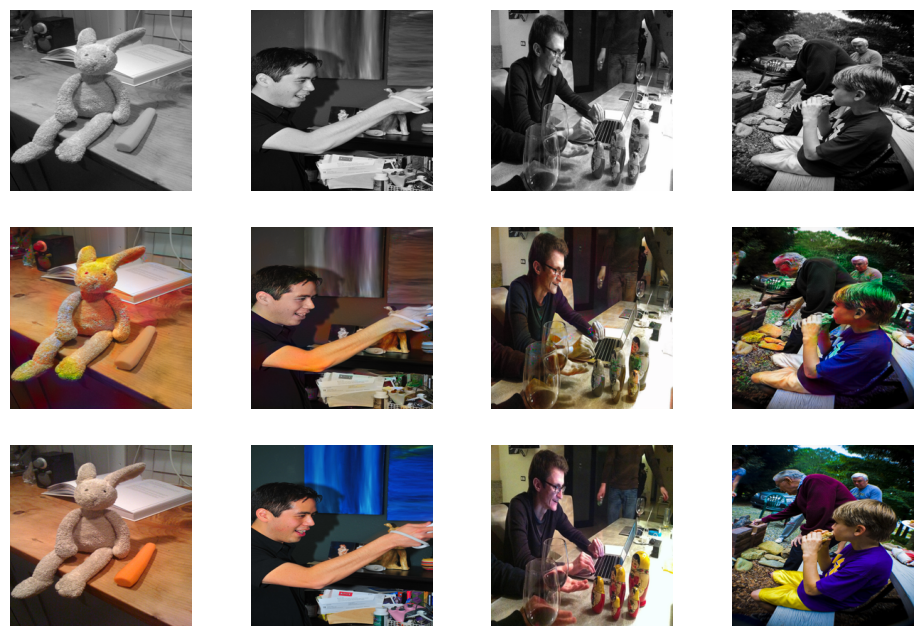

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 15/20
Iteration 200/250
loss_D_fake: 0.62970
loss_D_real: 0.61834
loss_D: 0.62402
loss_G_GAN: 0.95676
loss_G_L1: 6.74612
loss_G: 7.70289
model visulaize


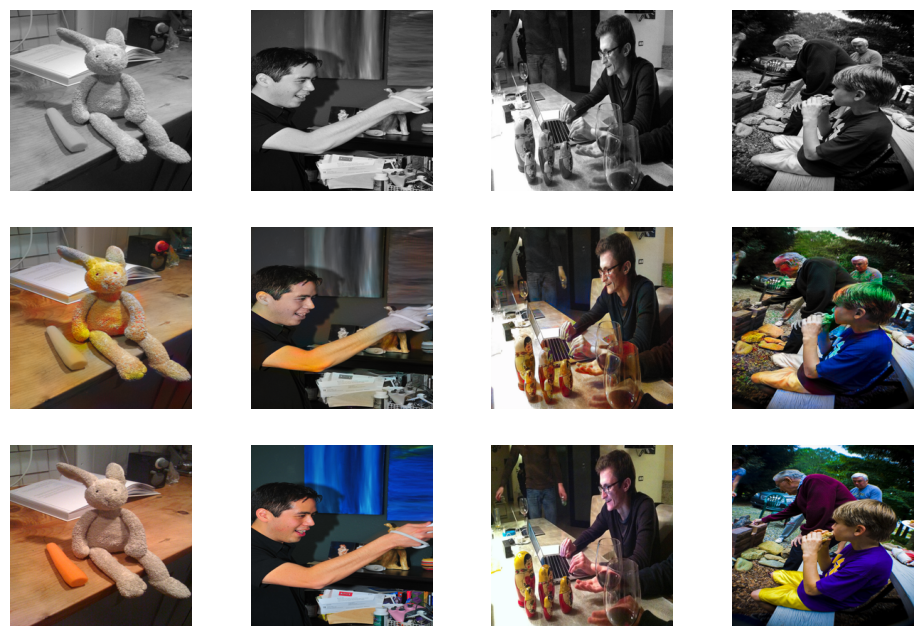

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 16/20
Iteration 200/250
loss_D_fake: 0.62863
loss_D_real: 0.62189
loss_D: 0.62526
loss_G_GAN: 0.94412
loss_G_L1: 6.57987
loss_G: 7.52399
model visulaize


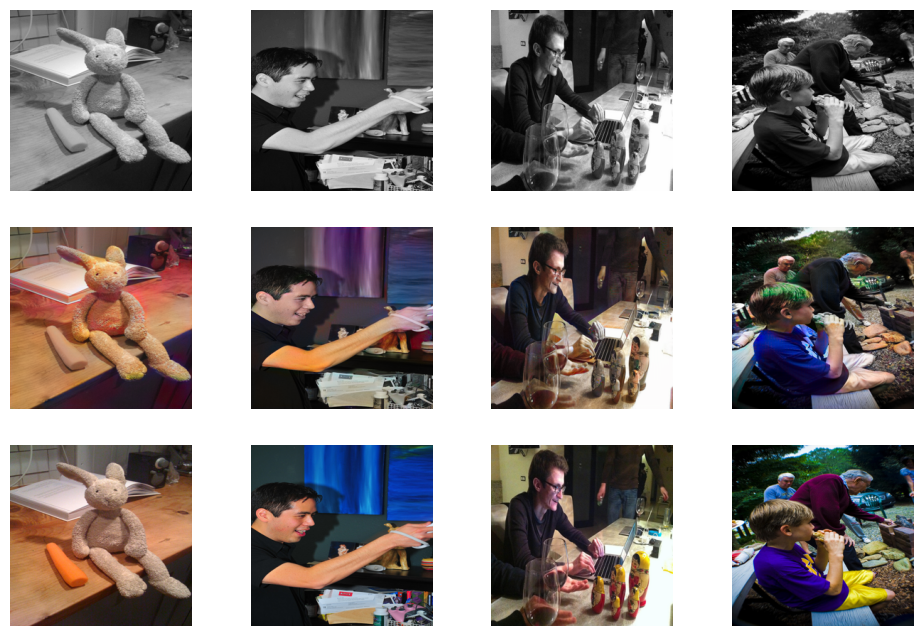

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 17/20
Iteration 200/250
loss_D_fake: 0.63109
loss_D_real: 0.62064
loss_D: 0.62586
loss_G_GAN: 0.93921
loss_G_L1: 6.41586
loss_G: 7.35507
model visulaize


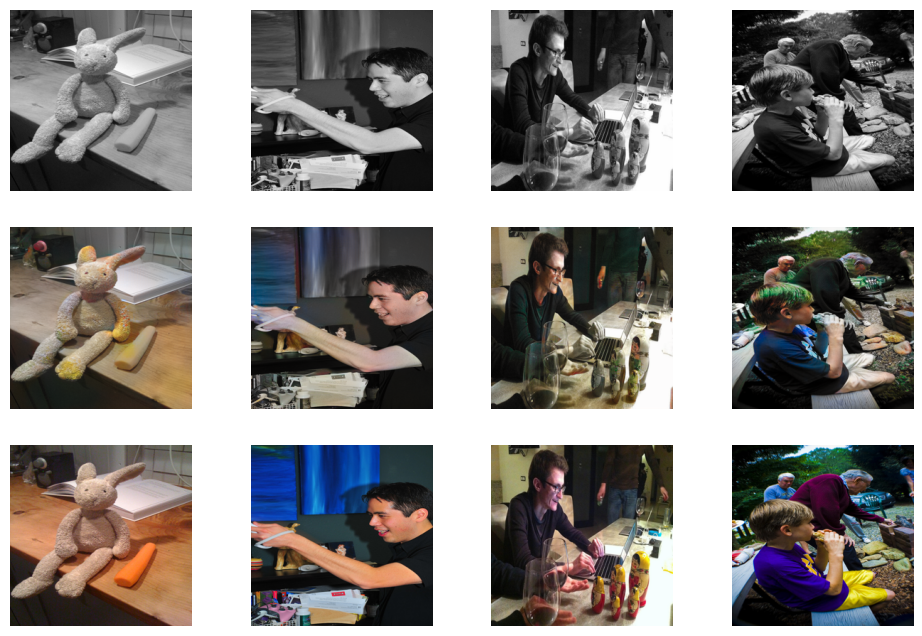

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 18/20
Iteration 200/250
loss_D_fake: 0.62555
loss_D_real: 0.62172
loss_D: 0.62363
loss_G_GAN: 0.93580
loss_G_L1: 6.25474
loss_G: 7.19053
model visulaize


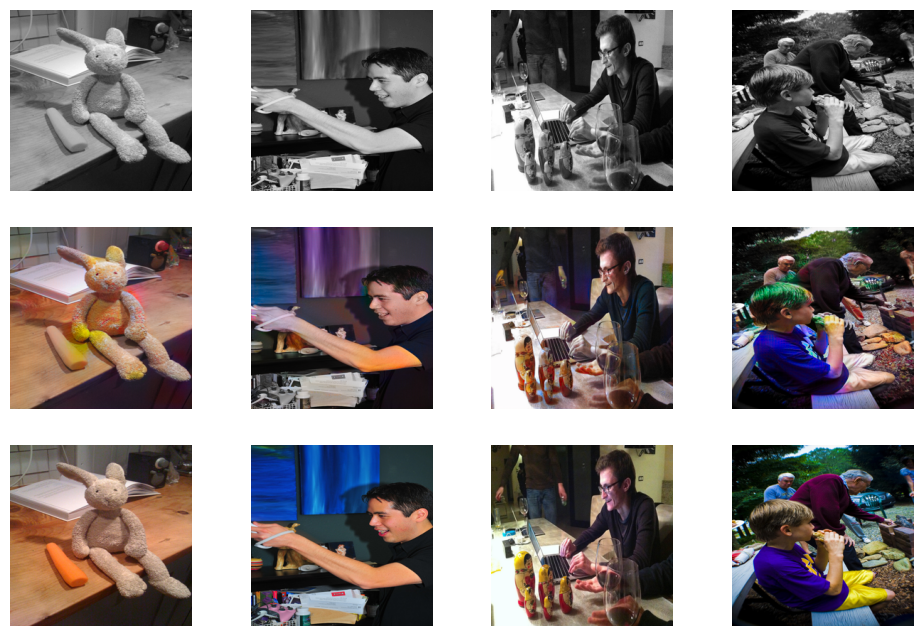

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 19/20
Iteration 200/250
loss_D_fake: 0.63243
loss_D_real: 0.62958
loss_D: 0.63101
loss_G_GAN: 0.92557
loss_G_L1: 6.13817
loss_G: 7.06374
model visulaize


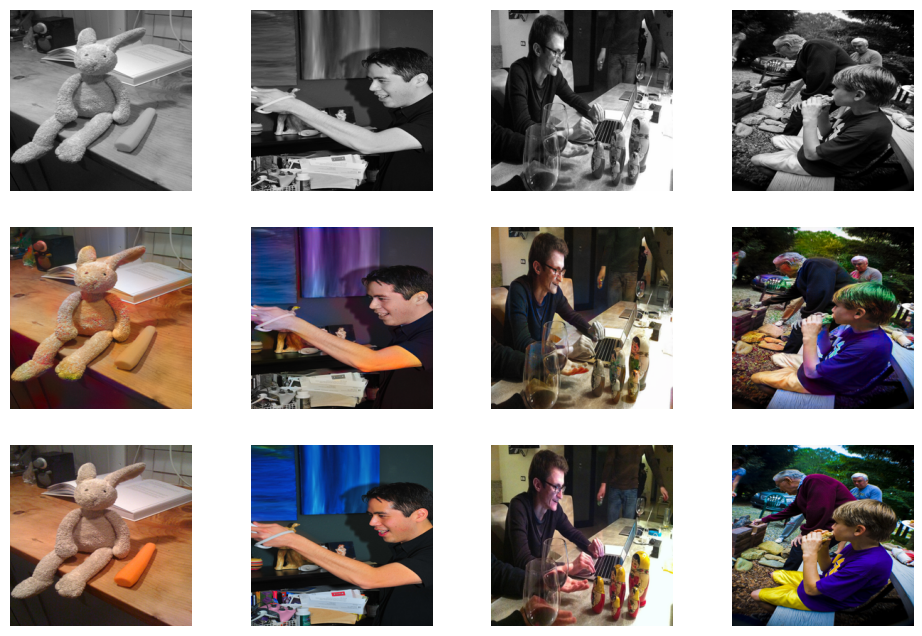

  0%|          | 0/250 [00:00<?, ?it/s]


Epoch 20/20
Iteration 200/250
loss_D_fake: 0.63604
loss_D_real: 0.63881
loss_D: 0.63743
loss_G_GAN: 0.94263
loss_G_L1: 6.05812
loss_G: 7.00075
model visulaize


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)


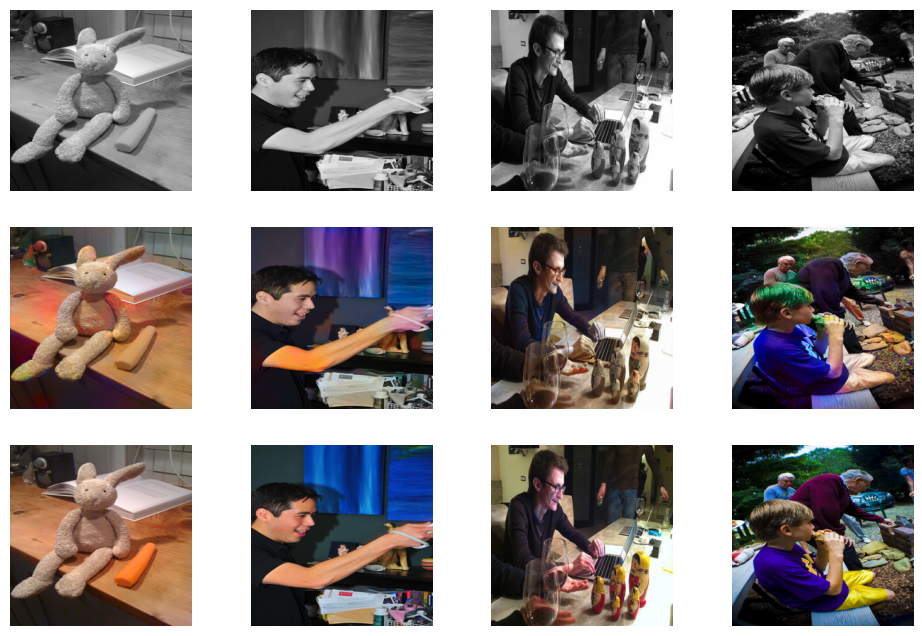

In [24]:
train_model(model, train_dl, 20)

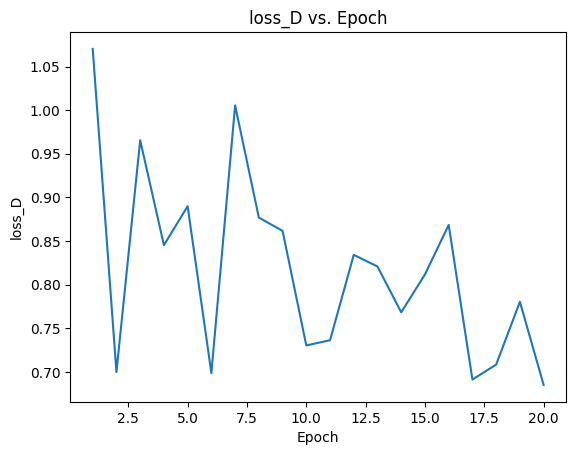

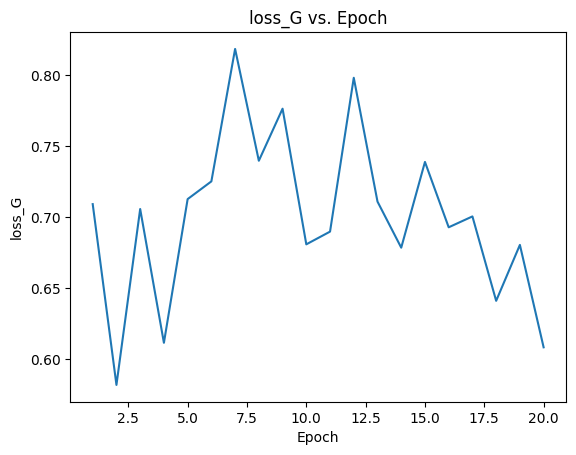

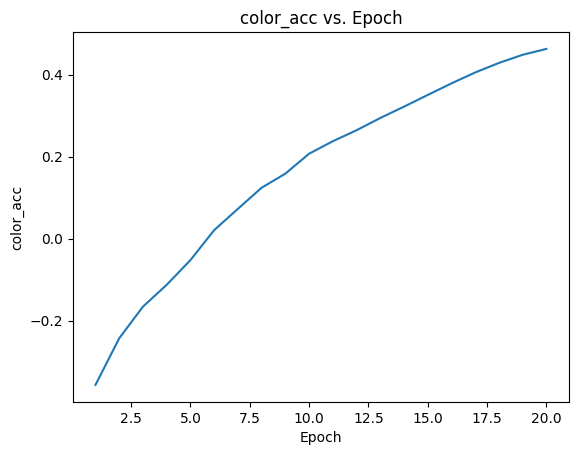

In [29]:
import matplotlib.pyplot as plt

# Loop over the keys in epoch_losses
for key in epoch_losses.keys():
    # Create a new figure and axes objects
    fig, ax = plt.subplots()

    # Plot the current key's values
    ax.plot(range(1, num_epochs + 1), epoch_losses[key])

    # Set the title and axis labels
    ax.set_title(f"{key} vs. Epoch")
    ax.set_xlabel('Epoch')
    ax.set_ylabel(key)

    # Show the plot
    plt.show()


0
original


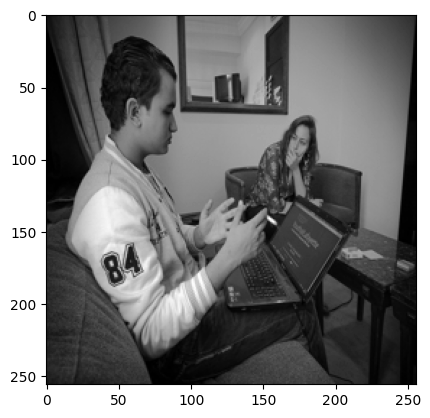

coloured by GAN


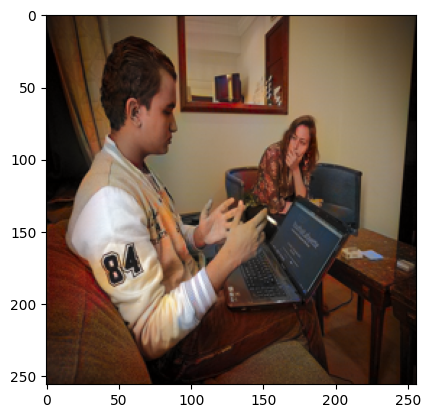

1
original


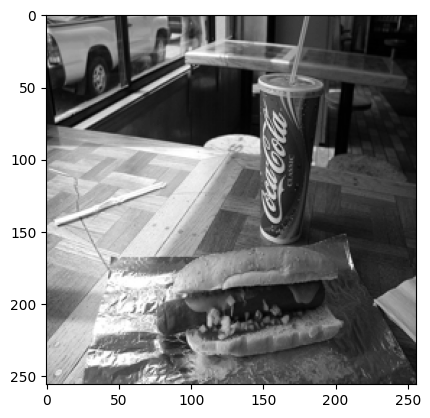

coloured by GAN


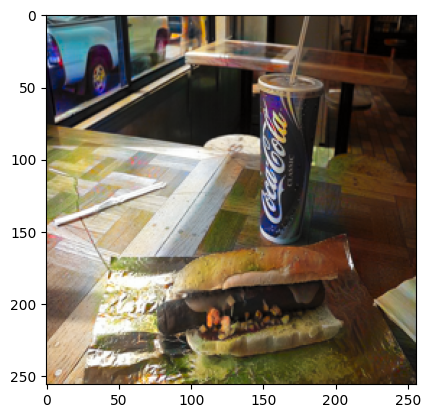

2
original


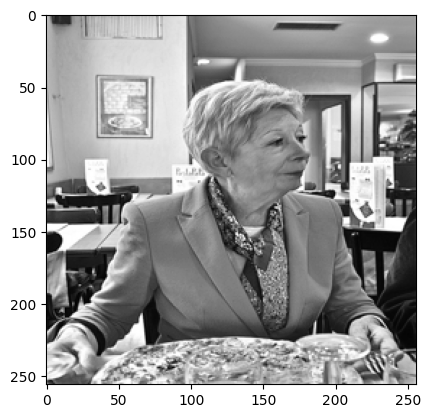

coloured by GAN


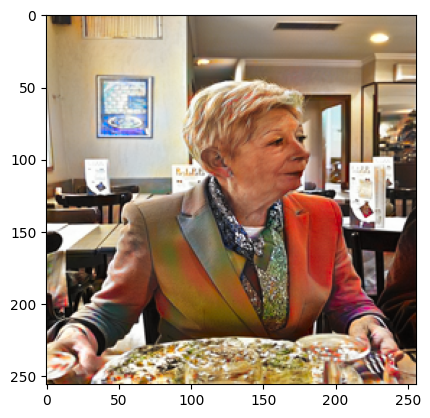

3
original


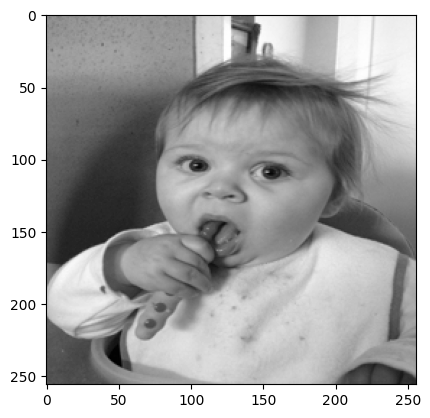

coloured by GAN


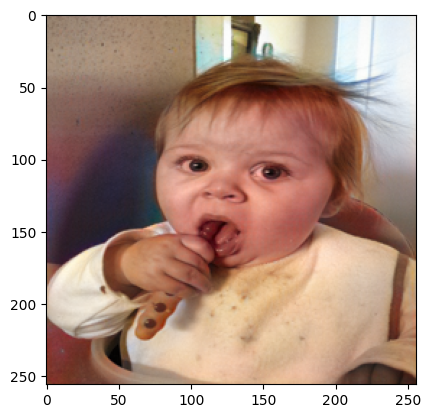

4
original


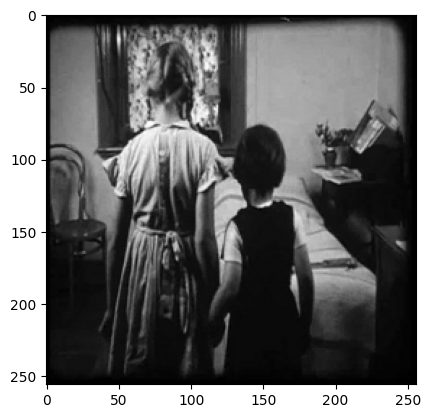

coloured by GAN


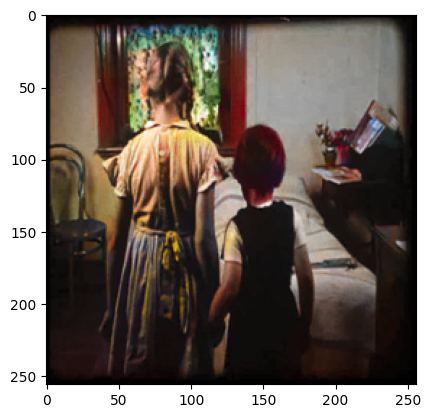

5
original


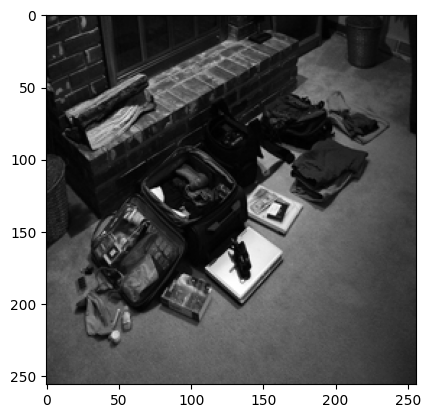

coloured by GAN


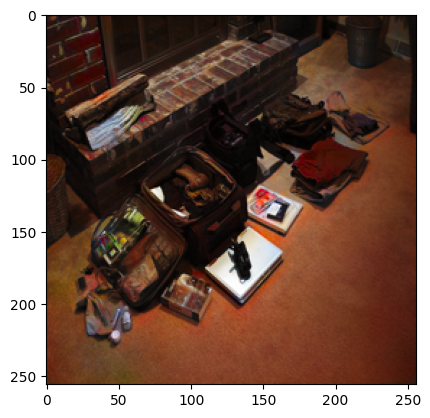

6
original


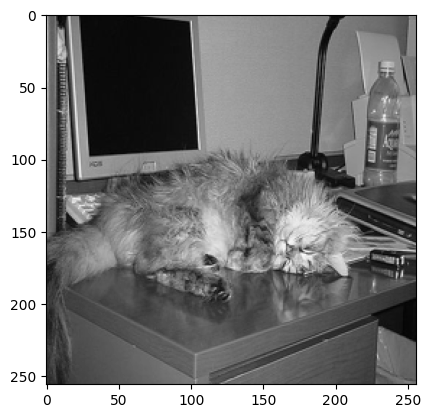

/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)


coloured by GAN


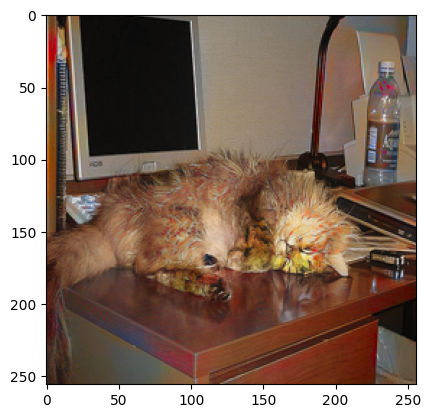

7
original


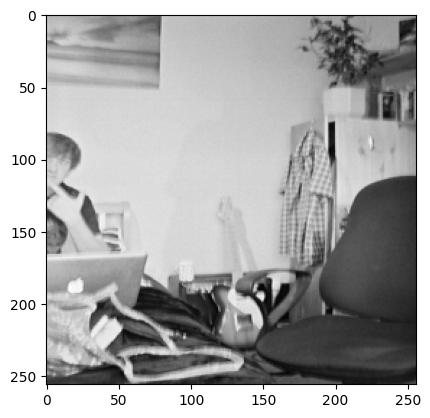

coloured by GAN


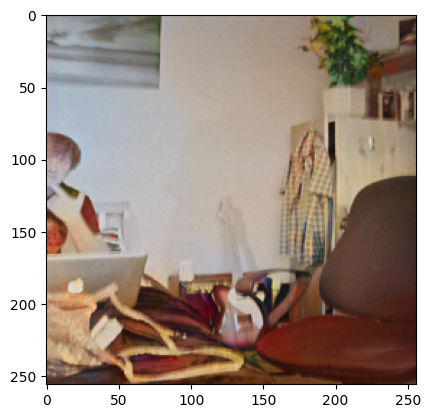

8
original


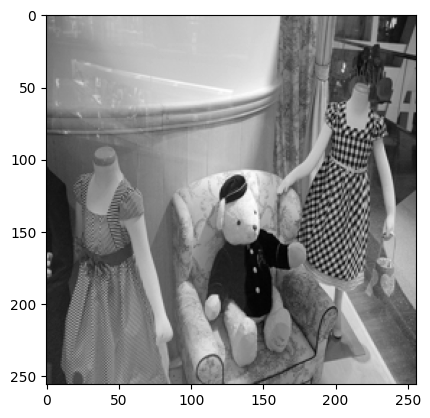

coloured by GAN


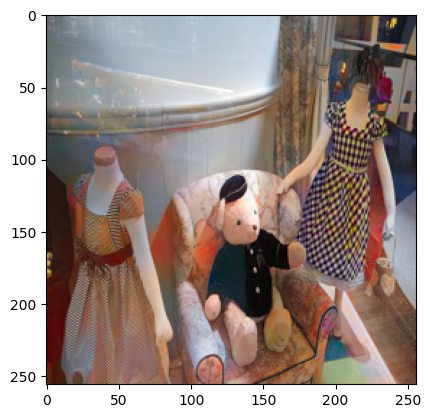

9
original


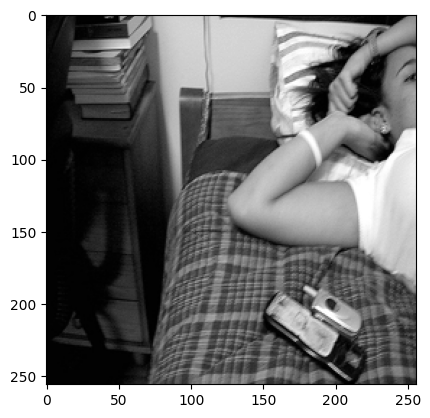

coloured by GAN


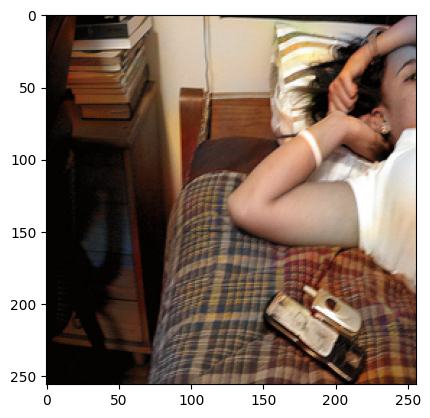

In [31]:
#In the modified code above, we first open the image and resize it to the desired size, then convert it to grayscale using the convert method and display 
# it using the imshow function. We then convert the colored image to grayscale using the rgb2gray function from scikit-image, and scale the resulting grayscale 
#image to [-1, 1]. Voila! We then feed the grayscale image to the model, get the colorized output
#convert it back to RGB using lab_to_rgb function, and display the resulting colored image using the imshow function.
import PIL
import skimage.color as skcolor
model.load_state_dict(torch.load("/content/drive/MyDrive/final_model_epoch_20.pt",map_location=device))
path = val_paths
for i in range(10):
    print(i)
    img = PIL.Image.open(path[i])
    img = img.resize((256, 256))
    img_gray = img.convert('L') # convert to grayscale
    print("original")
    plt.imshow(img_gray, cmap='gray')
    plt.show()
    # convert to colored image and scale to [-1, 1]
    img = skcolor.rgb2gray(np.array(img))  # convert to grayscale using scikit-image
    img = transforms.ToTensor()(img).unsqueeze(0) * 2. - 1.  # scale to [-1, 1] and add batch dimension
    model.eval()
    with torch.no_grad():
        preds = model.net_G(img.to(torch.float32).to(device))  # cast input tensor to torch.float32
    colorized = lab_to_rgb(img, preds.cpu())[0]
    print("coloured by GAN")
    plt.imshow(colorized)
    plt.show()